In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [12]:
# Root directory for dataset
dataroot = "apebase/data/"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 4
# gradient accumulation - bigger batch size is needed
accum_grad = 16
# effective batch size = accum_grad * batch_size
ef_size = batch_size * accum_grad

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

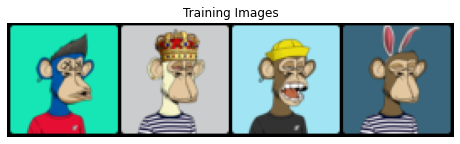

In [13]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:4], padding=2, normalize=True).cpu(),(1,2,0)))

In [14]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [15]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [16]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [17]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [18]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [19]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [22]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
print(f"Effective batch size: {batch_size * accum_grad}")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
#         netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        
        errD_real /= accum_grad
        
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        errD_fake /= accum_grad
        
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        if ((i + 1) % accum_grad == 0) or (i + 1 == len(dataloader)):
            optimizerD.step()
            optimizerD.zero_grad()
#         optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        errG /= accum_grad
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        if ((i + 1) % accum_grad == 0) or (i + 1 == len(dataloader)):
            optimizerG.step()
            optimizerG.zero_grad()
#         optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

Starting Training Loop...
Effective batch size: 64
[0/5][0/2500]	Loss_D: 0.1284	Loss_G: 0.0877	D(x): 0.2288	D(G(z)): 0.2626 / 0.2626
[0/5][50/2500]	Loss_D: 0.0414	Loss_G: 0.0934	D(x): 0.9391	D(G(z)): 0.3762 / 0.3762
[0/5][100/2500]	Loss_D: 0.0405	Loss_G: 0.0699	D(x): 0.9205	D(G(z)): 0.4010 / 0.4010
[0/5][150/2500]	Loss_D: 0.0266	Loss_G: 0.1125	D(x): 1.0000	D(G(z)): 0.2965 / 0.2965
[0/5][200/2500]	Loss_D: 0.1219	Loss_G: 0.0105	D(x): 0.9998	D(G(z)): 0.8480 / 0.8480
[0/5][250/2500]	Loss_D: 0.0390	Loss_G: 0.0630	D(x): 0.9318	D(G(z)): 0.4010 / 0.4010
[0/5][300/2500]	Loss_D: 0.1489	Loss_G: 0.0095	D(x): 0.9789	D(G(z)): 0.8674 / 0.8674
[0/5][350/2500]	Loss_D: 0.0632	Loss_G: 0.0653	D(x): 0.9989	D(G(z)): 0.4666 / 0.4666
[0/5][400/2500]	Loss_D: 0.0039	Loss_G: 0.2133	D(x): 0.9981	D(G(z)): 0.0573 / 0.0573
[0/5][450/2500]	Loss_D: 0.0687	Loss_G: 0.0264	D(x): 0.9960	D(G(z)): 0.6593 / 0.6593
[0/5][500/2500]	Loss_D: 0.0481	Loss_G: 0.0566	D(x): 0.9985	D(G(z)): 0.4780 / 0.4780
[0/5][550/2500]	Loss_D: 0.00

[1/5][2350/2500]	Loss_D: 0.0550	Loss_G: 0.0337	D(x): 0.9972	D(G(z)): 0.5837 / 0.5837
[1/5][2400/2500]	Loss_D: 0.0793	Loss_G: 0.0207	D(x): 0.9996	D(G(z)): 0.7187 / 0.7187
[1/5][2450/2500]	Loss_D: 0.0251	Loss_G: 0.0695	D(x): 0.9980	D(G(z)): 0.3293 / 0.3293
[2/5][0/2500]	Loss_D: 0.0601	Loss_G: 0.0302	D(x): 0.9992	D(G(z)): 0.6173 / 0.6173
[2/5][50/2500]	Loss_D: 0.0221	Loss_G: 0.0762	D(x): 0.9987	D(G(z)): 0.2962 / 0.2962
[2/5][100/2500]	Loss_D: 0.0659	Loss_G: 0.0269	D(x): 0.9991	D(G(z)): 0.6505 / 0.6505
[2/5][150/2500]	Loss_D: 0.0203	Loss_G: 0.0806	D(x): 0.9994	D(G(z)): 0.2765 / 0.2765
[2/5][200/2500]	Loss_D: 0.0628	Loss_G: 0.0289	D(x): 0.9997	D(G(z)): 0.6310 / 0.6310
[2/5][250/2500]	Loss_D: 0.0349	Loss_G: 0.0539	D(x): 0.9989	D(G(z)): 0.4255 / 0.4255
[2/5][300/2500]	Loss_D: 0.0540	Loss_G: 0.0343	D(x): 0.9982	D(G(z)): 0.5779 / 0.5779
[2/5][350/2500]	Loss_D: 0.0241	Loss_G: 0.0717	D(x): 0.9997	D(G(z)): 0.3191 / 0.3191
[2/5][400/2500]	Loss_D: 0.0292	Loss_G: 0.0618	D(x): 0.9992	D(G(z)): 0.3724 /

[3/5][2200/2500]	Loss_D: 0.0460	Loss_G: 0.0409	D(x): 0.9996	D(G(z)): 0.5205 / 0.5205
[3/5][2250/2500]	Loss_D: 0.0451	Loss_G: 0.0416	D(x): 0.9999	D(G(z)): 0.5143 / 0.5143
[3/5][2300/2500]	Loss_D: 0.0373	Loss_G: 0.0501	D(x): 0.9988	D(G(z)): 0.4485 / 0.4485
[3/5][2350/2500]	Loss_D: 0.0664	Loss_G: 0.0268	D(x): 0.9992	D(G(z)): 0.6525 / 0.6525
[3/5][2400/2500]	Loss_D: 0.0376	Loss_G: 0.0497	D(x): 0.9996	D(G(z)): 0.4520 / 0.4520
[3/5][2450/2500]	Loss_D: 0.0603	Loss_G: 0.0301	D(x): 0.9994	D(G(z)): 0.6182 / 0.6182
[4/5][0/2500]	Loss_D: 0.0453	Loss_G: 0.0416	D(x): 0.9999	D(G(z)): 0.5144 / 0.5144
[4/5][50/2500]	Loss_D: 0.0264	Loss_G: 0.0670	D(x): 0.9995	D(G(z)): 0.3432 / 0.3432
[4/5][100/2500]	Loss_D: 0.0647	Loss_G: 0.0275	D(x): 0.9989	D(G(z)): 0.6439 / 0.6439
[4/5][150/2500]	Loss_D: 0.0549	Loss_G: 0.0336	D(x): 0.9996	D(G(z)): 0.5840 / 0.5840
[4/5][200/2500]	Loss_D: 0.0505	Loss_G: 0.0372	D(x): 0.9998	D(G(z)): 0.5526 / 0.5526
[4/5][250/2500]	Loss_D: 0.0450	Loss_G: 0.0419	D(x): 0.9989	D(G(z)): 0.512

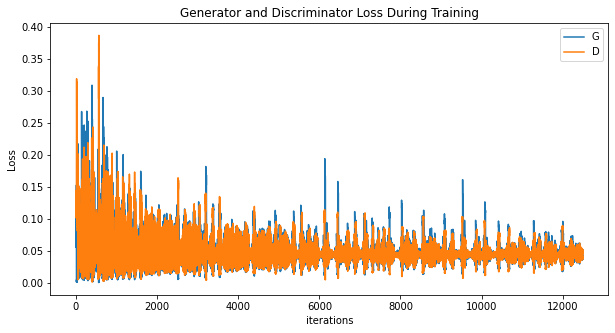

In [23]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

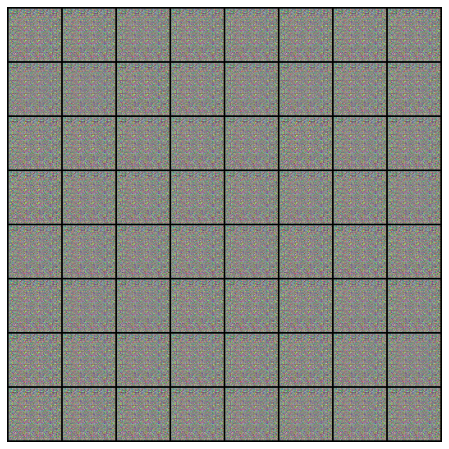

In [24]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

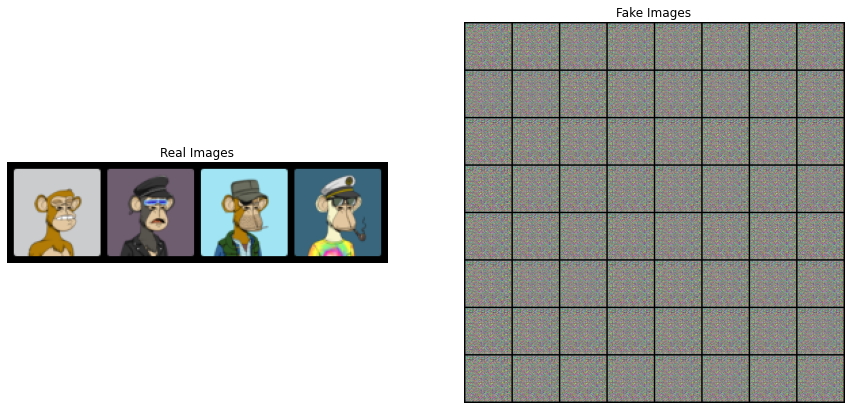

In [25]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [ ]:
plt.imshow(np.transpose(img_list[-4],(1,2,0)))
plt.show()

In [ ]:
noise = torch.randn(1, nz, 1, 1, device=device)
# Generate fake image batch with G
fake = netG(noise)

# label.fill_(fake_label)
# # Classify all fake batch with D
# output = netD(fake.detach()).view(-1)
# fake
# fake.detach().cpu()
plt.imshow(np.transpose(fake.detach().cpu()[0],(1,2,0)))
plt.show()